# Extended Yale Face Database B

For experimentation I am using the Extended Yale Face Database B, consisting of 38 individuals (28 from the extended database, and 10 from the original database). The database can be downloaded [here](http://vision.ucsd.edu/~leekc/ExtYaleDatabase/ExtYaleB.html). I am using a preprocessed .mat file from Steve Brunton's Databook.

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import scipy.io
import seaborn as sns

plt.rcParams['figure.figsize'] = [10, 10]
plt.rcParams.update({'font.size': 18})
plt.rcParams['figure.constrained_layout.use'] = True

mat_contents = scipy.io.loadmat('../data/allFaces.mat')
faces = mat_contents['faces']
m = int(mat_contents['m'])
n = int(mat_contents['n'])
nfaces = np.ndarray.flatten(mat_contents['nfaces'])

y = np.zeros((faces.shape[1],)) # Creating labels
j = 0
classes = list(range(len(nfaces)))
for i in nfaces:
  y[j:j+i] = classes.pop(0)
  j = j + i

print("Total dataset size:")
print(f"n_samples: {faces.shape[1]}")
print(f"n_features: {m*n}")
print(f"n_classes: {len(nfaces)}")

Total dataset size:
n_samples: 2410
n_features: 32256
n_classes: 38


## Preview
Prints a single image for each person in the Yale database.

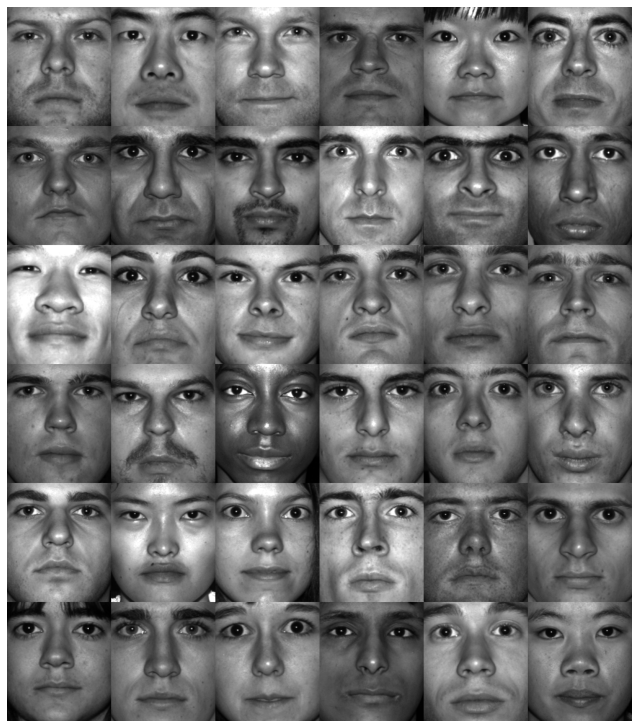

In [4]:
allPersons = np.zeros((n*6,m*6))
count = 0

for j in range(6):
    for k in range(6):
        allPersons[j*n : (j+1)*n, k*m : (k+1)*m] = np.reshape(faces[:,np.sum(nfaces[:count])],(m,n)).T
        count += 1
        
img = plt.imshow(allPersons)
img.set_cmap('gray')
plt.axis('off')
plt.show()

## Generating all portraits of 38 individuals
The code below generates a preview of all images for a specific person. You can see that some people don't have the full 64 set of pictures corresponding to the lighting conditions.

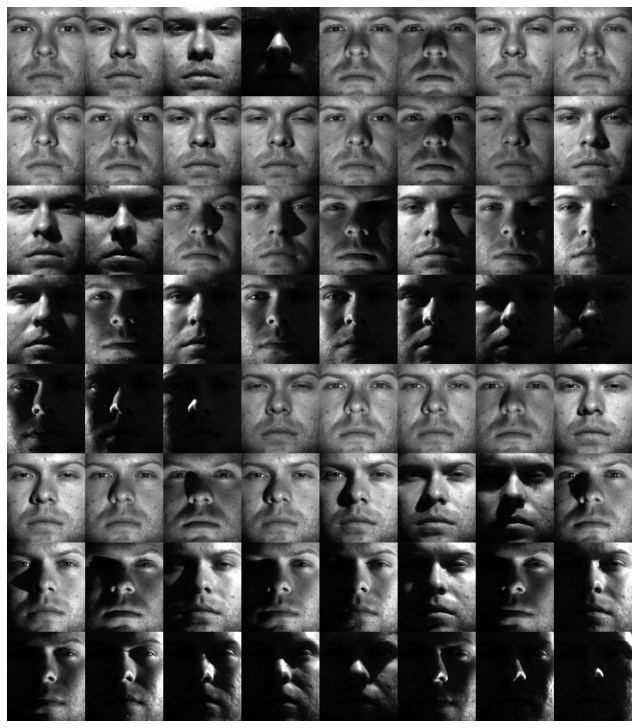

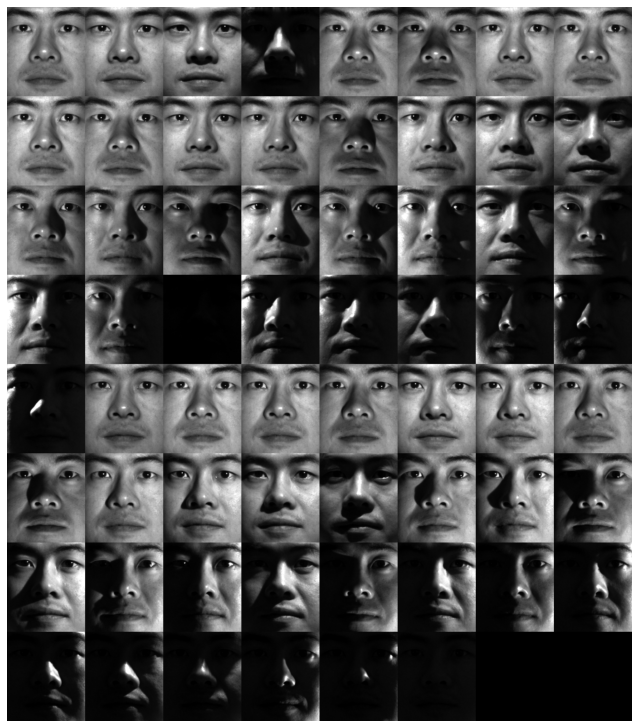

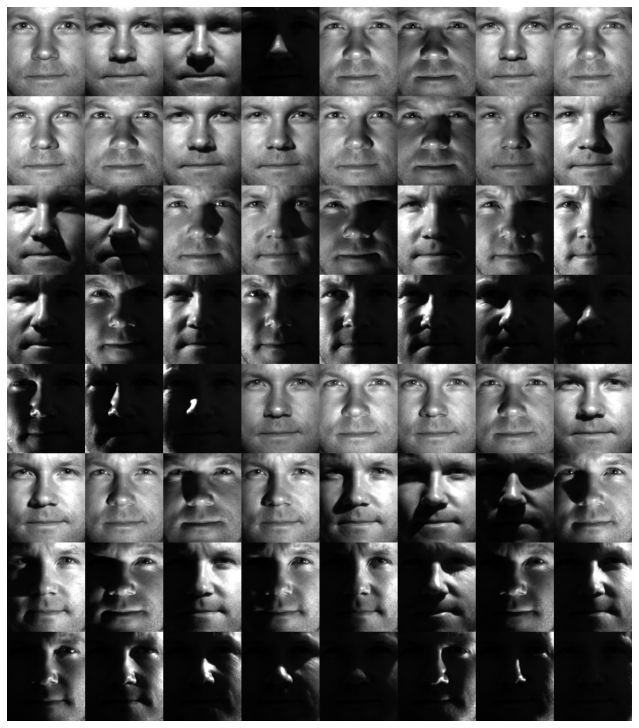

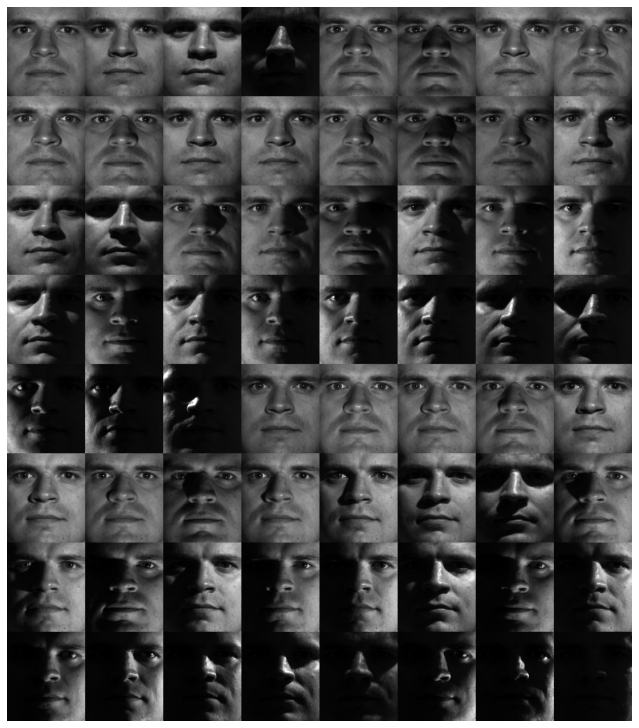

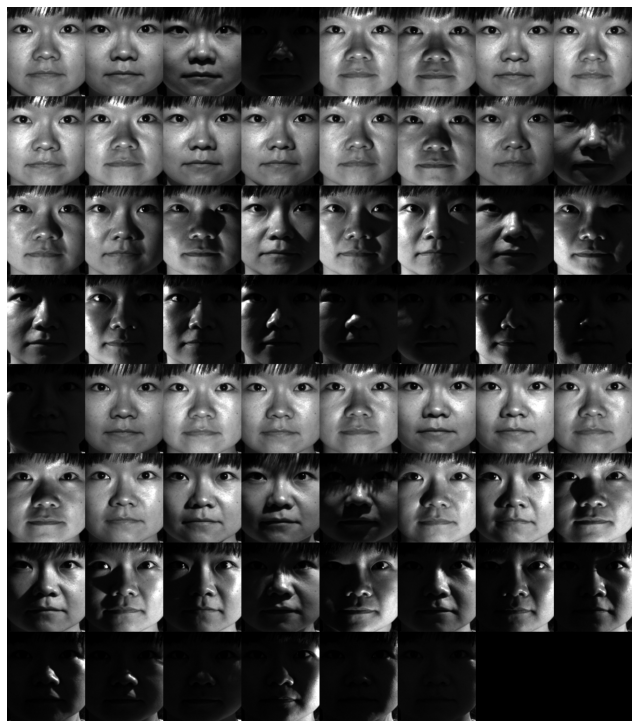

...

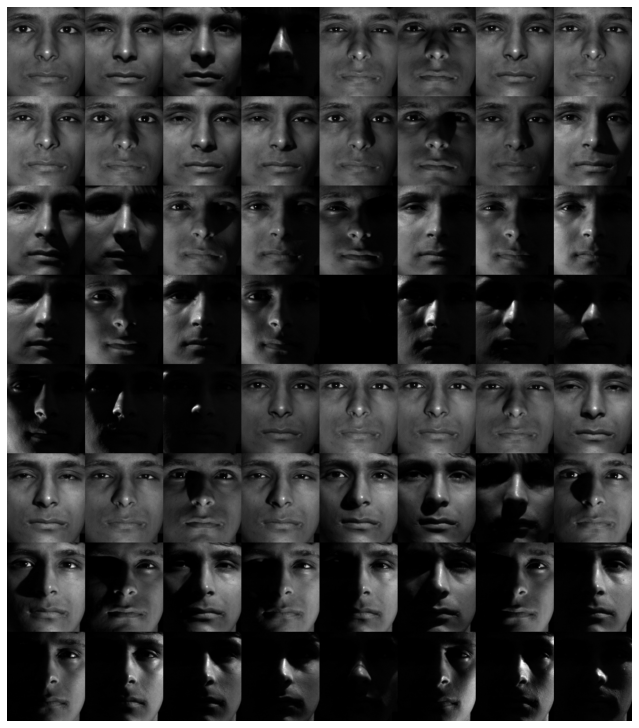

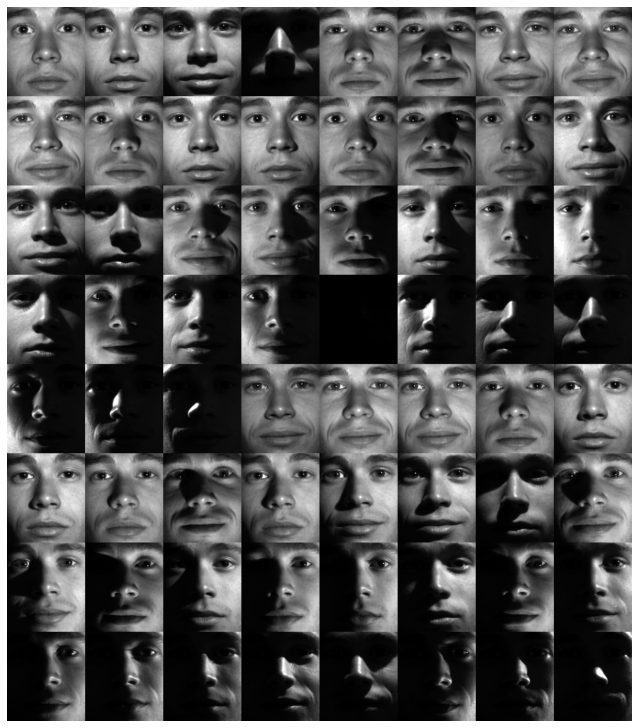

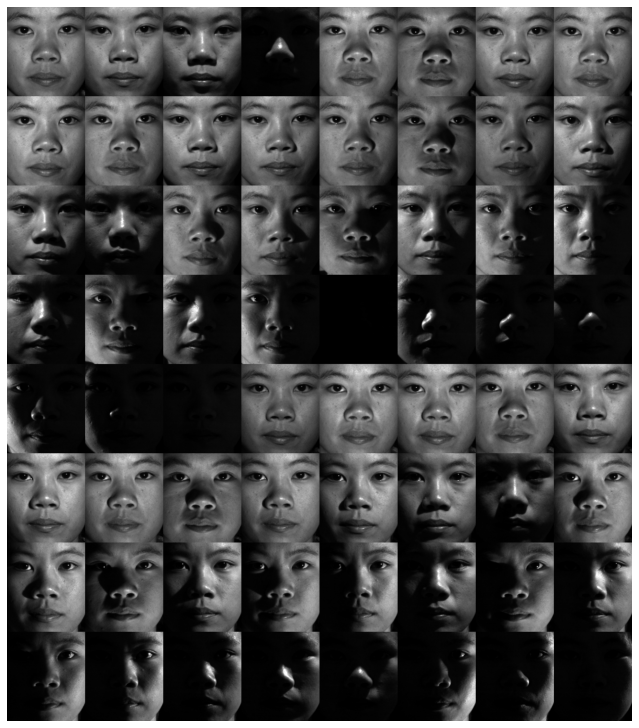

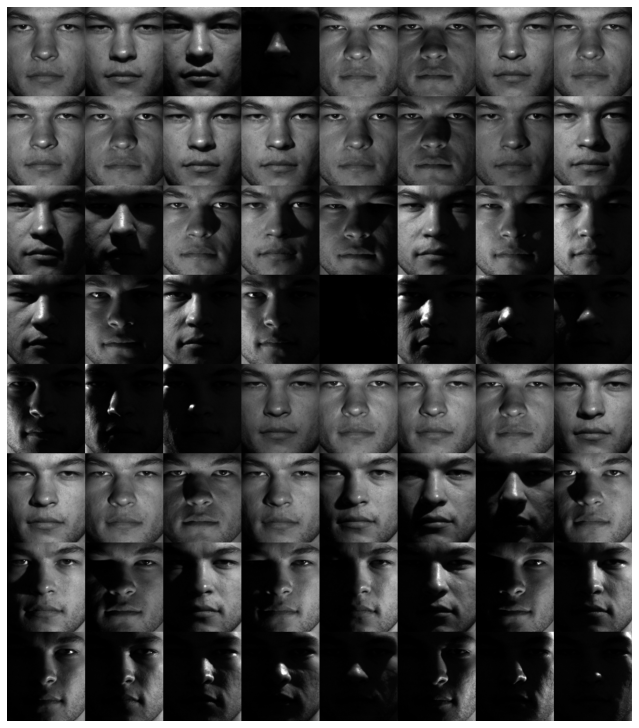

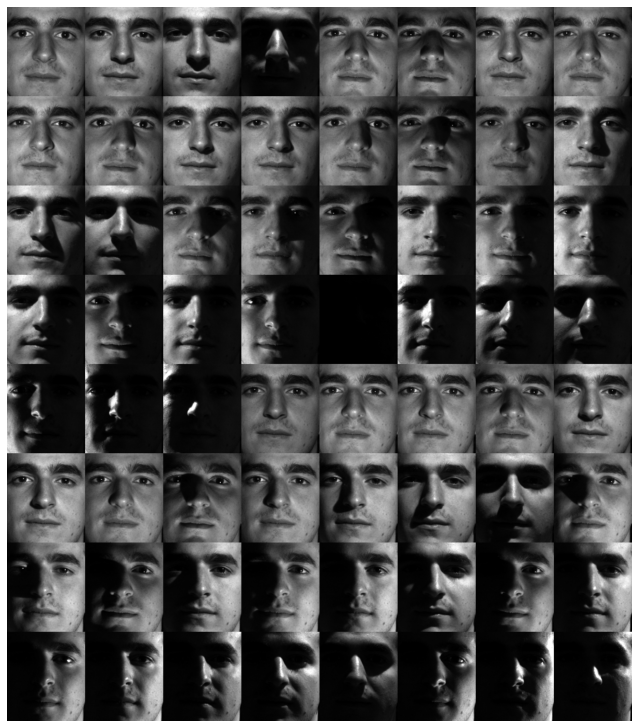

In [6]:
for person in range(len(nfaces)):
    subset = faces[:,sum(nfaces[:person]) : sum(nfaces[:(person+1)])]
    allFaces = np.zeros((n*8,m*8))
    
    count = 0
    
    for j in range(8):
        for k in range(8):
            if count < nfaces[person]:
                allFaces[j*n:(j+1)*n,k*m:(k+1)*m] = np.reshape(subset[:,count],(m,n)).T
                count += 1
                
    img = plt.imshow(allFaces)
    img.set_cmap('gray')
    plt.axis('off')
    
    # Save files
    fileName = f"P{person+1:02d}"
    # plt.savefig(f'../data/previews/{fileName}.pdf')
    plt.show()


## Histogram

Show how the classes are distributed within the dataset, notice how some classes (e.g. Person 12) are less repersented due to data corruption. Nevertheless overall the dataset is pretty balanced.

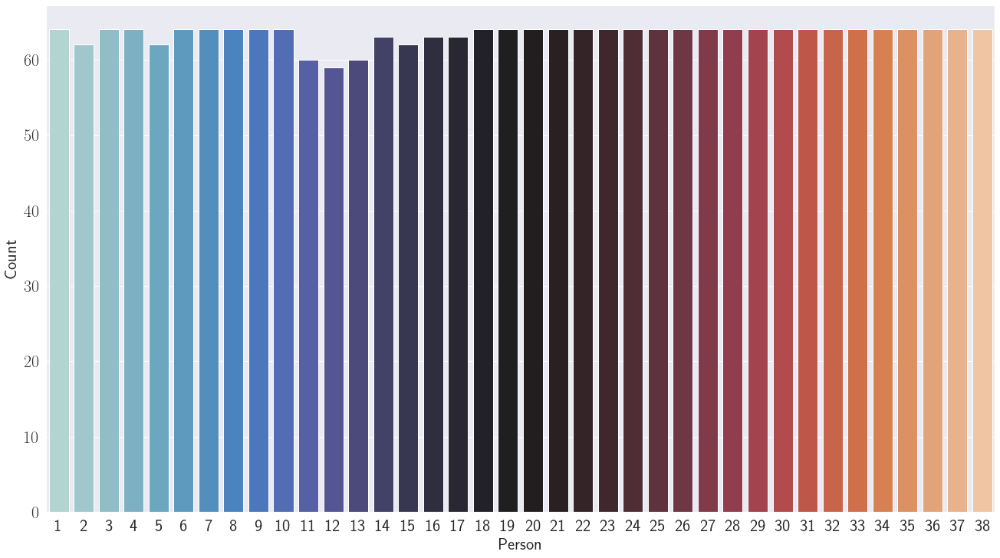

In [2]:
sns.set(style="darkgrid")
plt.rc('text', usetex=True)
plt.rc('xtick', labelsize=22)
plt.rc('ytick', labelsize=22)
plt.rc('axes', labelsize=22)

fig = plt.figure(figsize=(18, 10))
ax = sns.countplot(y, palette='icefire')
ax.set_xticklabels(range(1, 39))
ax.set_ylabel("Count")
ax.set_xlabel("Person")